In [49]:
# import paket pandas
import pandas as pd
from tqdm import tqdm

# baca data
data = pd.read_csv('train.csv')
data['date'] = pd.to_datetime(data['date'])
data.head()

,date,store,item,sales
0,2013-01-01,1,1,13
1,2013-01-02,1,1,11
2,2013-01-03,1,1,14
3,2013-01-04,1,1,13
4,2013-01-05,1,1,10


In [50]:
# gabungkan kolom toko dan item sebagai time_series
data['store'] = ['store_'+str(i) for i in data['store']]
data['item'] = ['item_' + str(i) for i in data['item']]
data['time_series'] = data[['store','item']].apply(lambda x: '_'.join(x),axis=1)
data.drop(['store','item'],axis=1,inplace=True)
#tampikan hasil gabungan data
data.head()

,date,sales,time_series
0,2013-01-01,13,store_1_item_1
1,2013-01-02,11,store_1_item_1
2,2013-01-03,14,store_1_item_1
3,2013-01-04,13,store_1_item_1
4,2013-01-05,10,store_1_item_1


In [51]:
# ekstrak fitur dari tanggal
data['month'] = [i.month for i in data['date']]
data['year'] = [i.year for i in data['date']]
data['day_of_week'] = [i.dayofweek for i in data['date']]
data['day_of_year'] = [i.dayofyear for i in data['date']]

In [52]:
#tampilkan data finish
data.head()

,date,sales,time_series,month,year,day_of_week,day_of_year
0,2013-01-01,13,store_1_item_1,1,2013,1,1
1,2013-01-02,11,store_1_item_1,1,2013,2,2
2,2013-01-03,14,store_1_item_1,1,2013,3,3
3,2013-01-04,13,store_1_item_1,1,2013,4,4
4,2013-01-05,10,store_1_item_1,1,2013,5,5


In [53]:
# periksa data time series yang unik
data['time_series'].nunique()

500

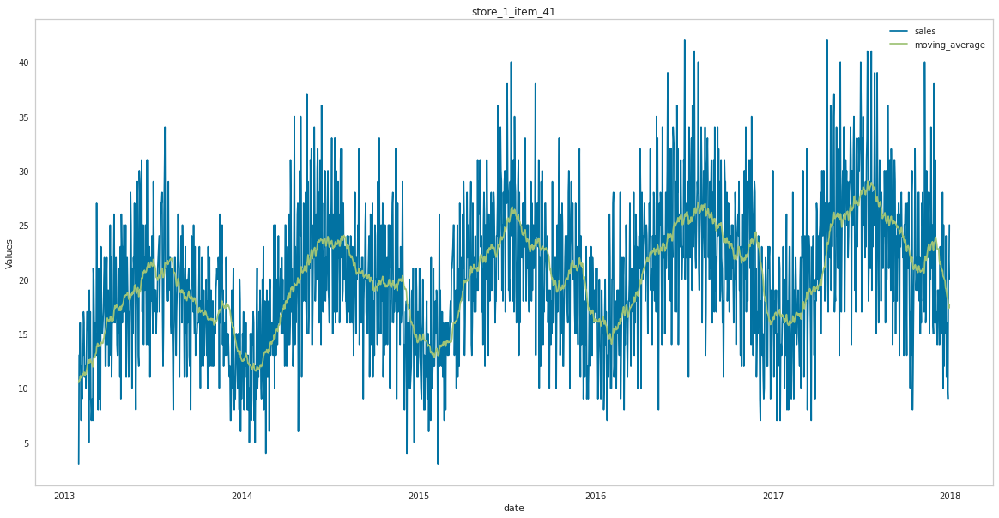

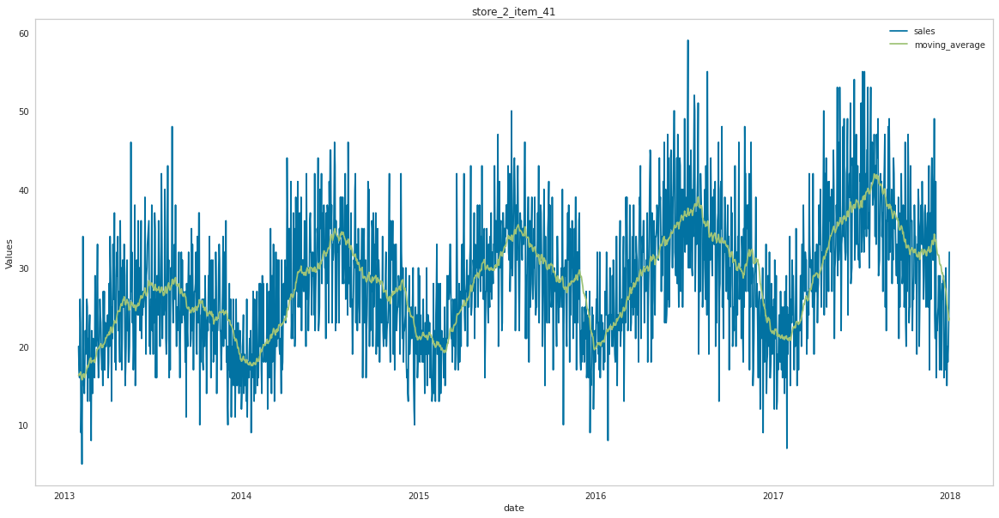

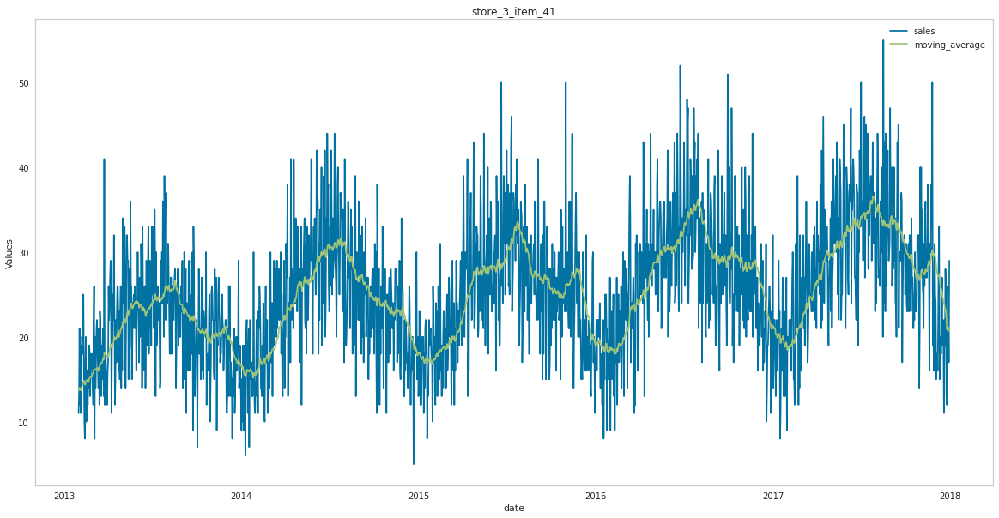

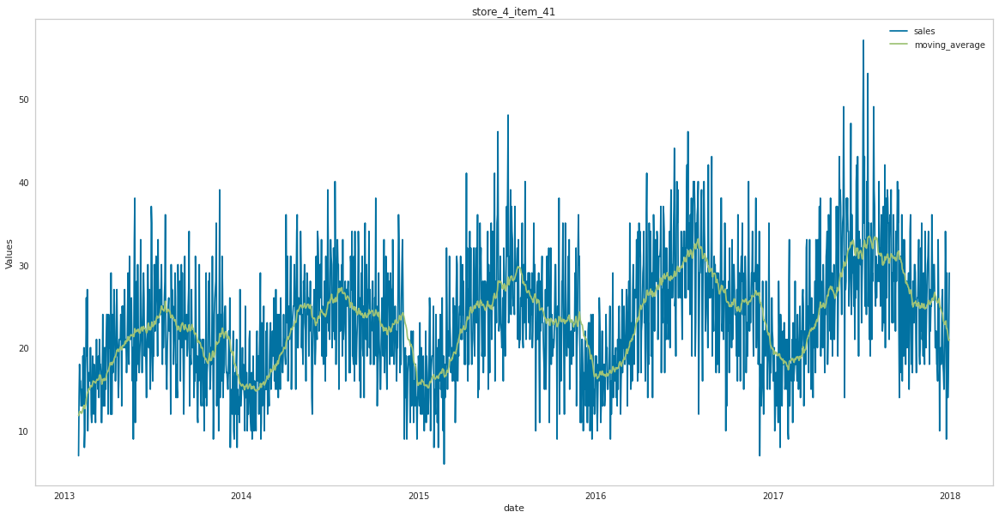

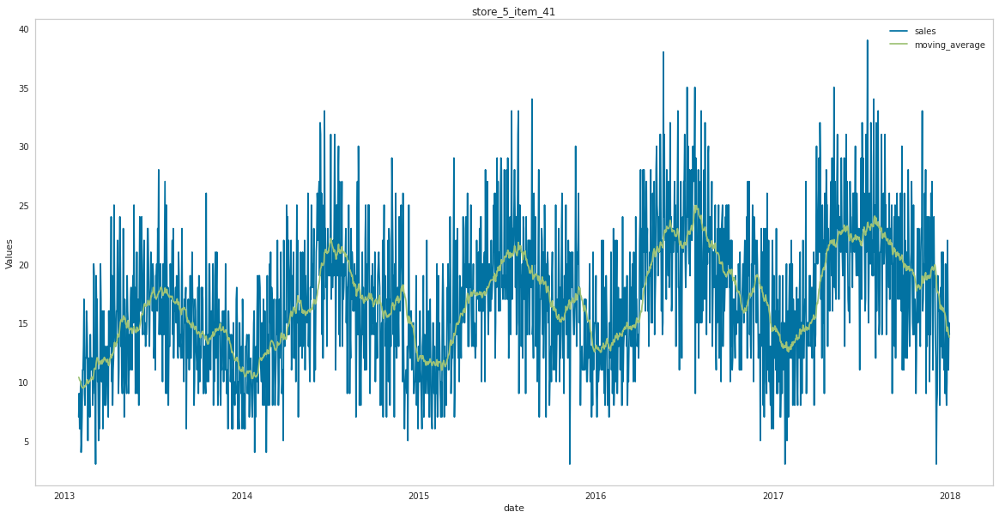

...

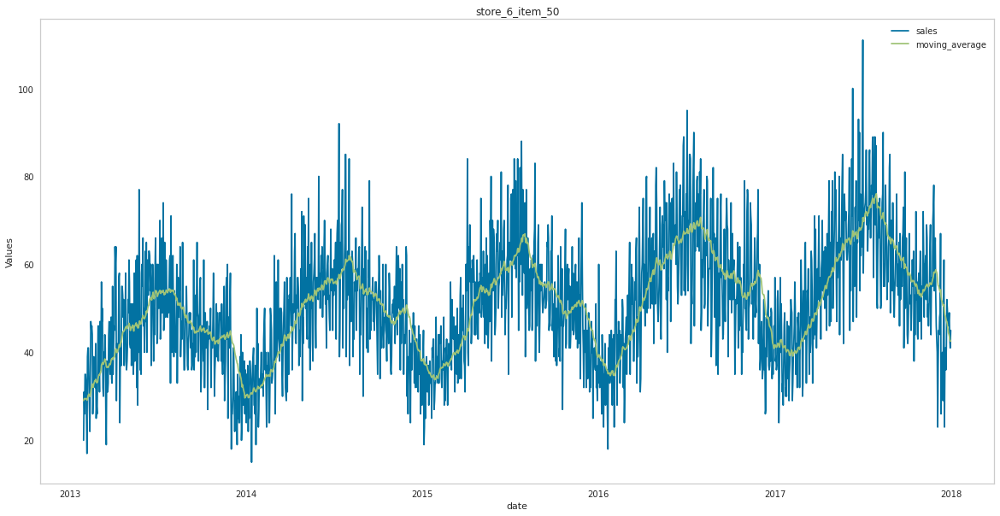

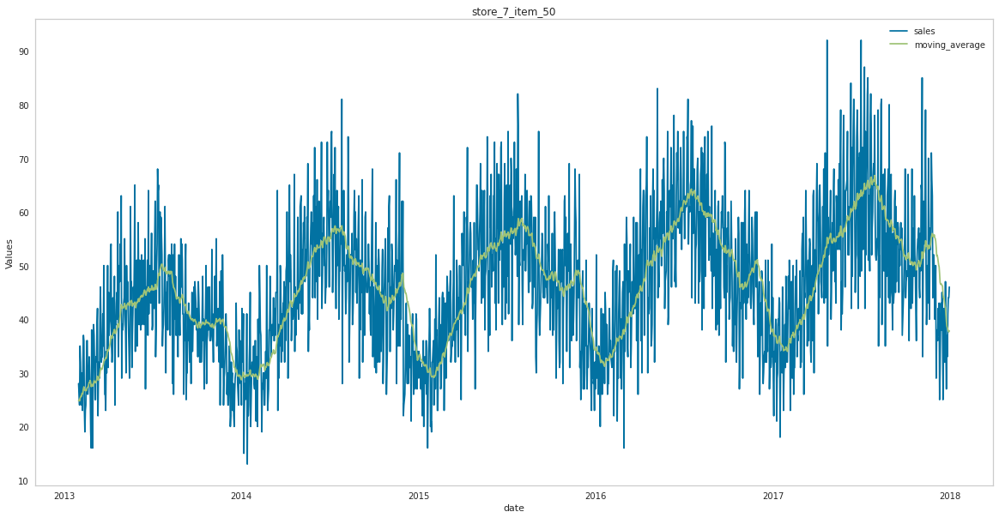

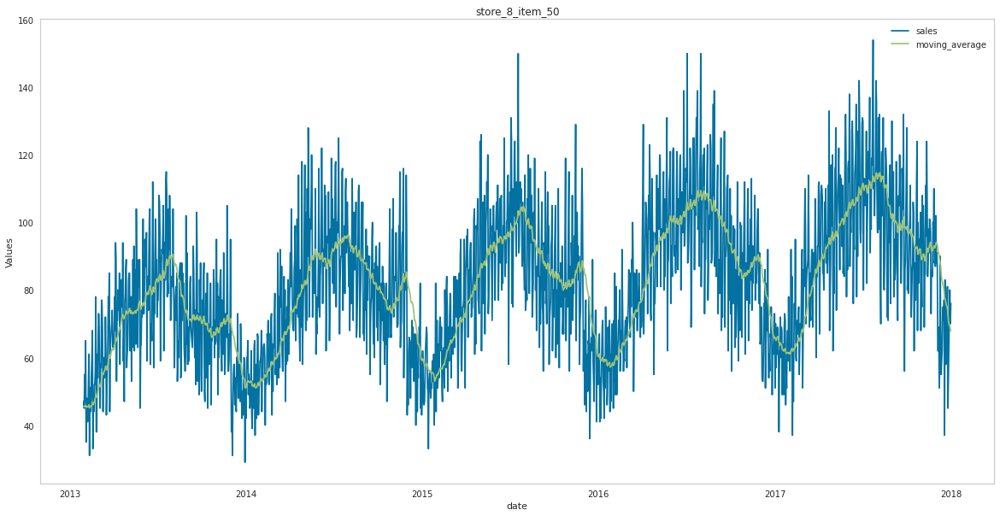

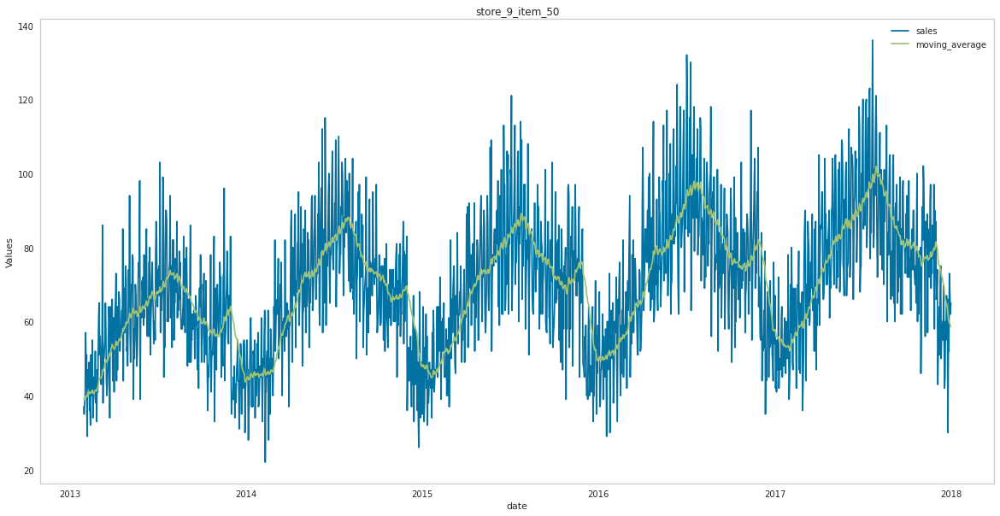

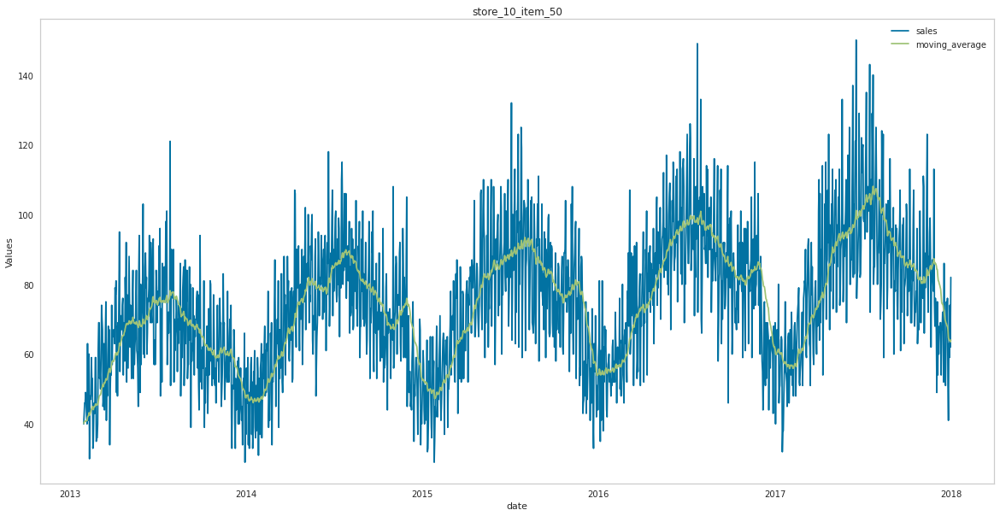

In [38]:
import matplotlib.pyplot as plt
import warnings
plt.rcParams.update({'figure.max_open_warning': 0})
import seaborn as sns
for i in list(data['time_series'].unique()[400:500]):
    subset = data[data['time_series'] == i]
    subset['moving_average'] = subset['sales'].rolling(30).mean()
    subset.dropna(inplace=True)
    warnings.simplefilter(action="error", category = FutureWarning )
    #set figure size
    plt.figure( figsize = (20,10) )
    
    #plot a simple time series plot
    #using seaborn.lineplot()
    sns.lineplot( x = 'date',y = 'sales',data = subset,label = 'sales')
                
    #plot using rolling average
    sns.lineplot( x = 'date',y = 'moving_average',data = subset,label = 'moving_average')
    plt.ylabel("Values")
    plt.grid()
    
    plt.title(i)

In [54]:
from pycaret.regression import *
all_ts = data['time_series'].unique()
all_results = []
final_model = {}

In [55]:
import warnings
from tqdm import tqdm 
all_ts = data['time_series'].unique()[400:500]
for i in tqdm(all_ts):
    df_subset = data[data['time_series']==i]
    #df_subset = data['time_series'].unique()[400:500]
    warnings.simplefilter(action="error", category = FutureWarning )
    # initialize setup from  pycaret.regression
    s = setup(df_subset, target = 'sales', train_size=0.95,
              data_split_shuffle = False, fold_strategy = 'timeseries',fold = 3,
              ignore_features = ['date','time_series'],numeric_features = ['day_of_year','year'],
              categorical_features = ['month','day_of_week'],silent = True, verbose = False, session_id = 123)
    # Compare all models and select best one based on MAE
    best_model = compare_models(sort = 'MAE', verbose = False)

    # Capture the compare result grid and store best model in list
    p = pull().iloc[0:1]
    p['time_series'] = str(i)
    all_results.append(p)
    
    # Finalize model i.e. fit on entire data including test set
    f = finalize_model(best_model)
    
    #attach final model to a dictionary
    final_model[i] = f
    
    #save transformation pipeline and model as pickle file
    save_model(f, model_name='trained_models/'+str(i), verbose = False)
    # save transformation pipeline and model 
    #save_model(lr, model_name = 'c:/username/ins/deployment_28042020')


  0%|                                                                                           | 0/100 [00:00<?, ?it/s]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=lightgbm, ordinal_features=None, high_cardinality_features=None, high_cardinality_method=

INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e8423a0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO:logs:display_container: 2
INFO:logs:L

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Decision Tree Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=1

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Light Gradient Boosting Machine
INFO:logs:Total runtime is 0.5063987652460734 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lightgbm, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e8423a0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient 

INFO:logs:save_model() successfully completed......................................
  1%|▊                                                                                  | 1/100 [00:33<54:50, 33.23s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=light

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32db4a760>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Decision Tree Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=1

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Light Gradient Boosting Machine
INFO:logs:Total runtime is 0.15118274291356404 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lightgbm, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32db4a760>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient

INFO:logs:save_model() successfully completed......................................
  2%|█▋                                                                                 | 2/100 [00:45<34:08, 20.91s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=light

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32cefd100>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Decision Tree Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=1

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Light Gradient Boosting Machine
INFO:logs:Total runtime is 0.13740660746892291 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lightgbm, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32cefd100>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient

INFO:logs:save_model() successfully completed......................................
  3%|██▍                                                                                | 3/100 [00:56<26:33, 16.42s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=light

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32eefe850>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Decision Tree Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=1

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Light Gradient Boosting Machine
INFO:logs:Total runtime is 0.1270601232846578 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lightgbm, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32eefe850>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient 

INFO:logs:save_model() successfully completed......................................
  4%|███▎                                                                               | 4/100 [01:07<22:49, 14.26s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=light

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff307611910>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Decision Tree Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_coef_ was depr

INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Random Forest Regressor
INFO:logs:Total runtime is 0.07110544443130494 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=rf, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff307611910>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Random Forest Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calcu

INFO:logs:Importing untrained model
INFO:logs:Light Gradient Boosting Machine Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 17
INFO:logs:master_model_container: 17
INFO:logs:display_container: 2
INFO:logs:LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
              random_state=123, reg_alpha=0.0, reg_lambda=0.0, silent='warn',
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0)
INFO:logs:create_model() succesfully complet

INFO:logs:save_model() successfully completed......................................
  5%|████▏                                                                              | 5/100 [01:18<20:47, 13.13s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=light

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e488490>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
 warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/li

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.09033671220143637 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e488490>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: bc49
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.020835359891255695 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32cf32610>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.0727580189704895 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32cf32610>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regr

  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_intercept_ was deprecated in version 0.23 and will be removed in 0.

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing K Neighbors Regressor
INFO:logs:Total runtime is 0.0890116810798645 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=knn, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32cf32610>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:K Neighbors Regressor Imported

INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 2
INFO:logs:AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=50, random_state=123)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Gradient Boosting Regressor
INFO:logs:Total runtime is 0.1574256976445516 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=gbr, fold=TimeSeries

INFO:logs:Finalizing BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False)
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False), fold=None, round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=False, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:log

INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 6333
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'USI', 'X_test', 'fold_group

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.017437764008839923 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33021b250>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:l

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.04610065619150797 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33021b250>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross valid

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.10070579449335733 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33021b250>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: cc68
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.016158318519592284 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33146ceb0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.044632514317830406 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33146ceb0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Re

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.09668020009994507 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33146ceb0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercep

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 6bfd
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01620633602142334 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32d1a7970>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.04361790815989176 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32d1a7970>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
s.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/linear_model/_least_angle.py:571: ConvergenceWarning: Regressors in active set degenerate. Dropping a regressor, after 19 iterations, i.e. alpha=9.224e-07, with an active set of 19 regressors, and the smallest cholesky pivot element being 2.220e-16. Reduce max_iter or increase eps parameters.
  warnings.warn('Regressors in active set degenerate. '
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.09346926212310791 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32d1a7970>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=No

INFO:logs:save_model() successfully completed......................................
 10%|████████▏                                                                         | 10/100 [02:16<17:50, 11.90s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=light

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e37f700>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/ho

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Random Forest Regressor
INFO:logs:Total runtime is 0.17844988505045573 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=rf, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e37f700>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Random Forest Regressor Impo

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient Boosting Machine Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 17
INFO:logs:master_model_container: 17
INFO:logs:display_container: 2
INFO:logs:LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
              random_state=123, reg_al

INFO:logs:save_model() successfully completed......................................
 11%|█████████                                                                         | 11/100 [02:35<20:50, 14.05s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=light

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3073e8c40>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Decision Tree Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=1

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Light Gradient Boosting Machine
INFO:logs:Total runtime is 0.15993793805440265 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lightgbm, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3073e8c40>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient

INFO:logs:save_model() successfully completed......................................
 12%|█████████▊                                                                        | 12/100 [02:49<20:14, 13.80s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=light

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff307611a60>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.06383660634358723 minutes
INFO:logs:SubProcess create_model() called =============================

  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.

INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=-1, oob_score=False,
                    random_state=123, verbose=0, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing AdaBoost Regressor
INFO:logs:Total runtime is 0.14851839939753214 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimato

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed......................................
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:compare_models() succesfully completed......................................
INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fit_kwargs=None, groups=None, model_only=True, display=None)
INFO:logs:Finalizing L

INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 8cd0
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'USI', 'X_test', 'fold_group

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.020386238892873127 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32cedcc10>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:l

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.05533875226974487 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32cedcc10>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross valid

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.1313029408454895 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32cedcc10>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported 

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 1d0b
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.013374455769856772 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303d03e50>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.041953047116597496 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303d03e50>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Re

INFO:logs:Initializing create_model()
//scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/s

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.1194261908531189 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303d03e50>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported 

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: f5bf
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.014503820737202962 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30484d250>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.039801291624705 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30484d250>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regre

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.09039252599080404 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30484d250>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: fb86
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01365968386332194 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32ceeb7f0>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03612311681111654 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32ceeb7f0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.04023331801096598 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed.

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 119b
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01351433992385864 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32f094280>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03528163433074951 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32f094280>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.03923201560974121 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Bayesian Ridge Imported succesfully
INFO:logs:Cross val

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 1b44
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.013302795092264811 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303bca640>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.0539618452390035 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303bca640>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regr

  warnings.warn(msg, INFO:logs:create_model_container: 10
INFO:logs:master_model_container: 10
INFO:logs:display_container: 2
INFO:logs:HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute av

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed.

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 633d
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.016457800070444742 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff330e1d160>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.0416070580482483 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff330e1d160>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regr

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 10
INFO:logs:master_model_container: 10
INFO:logs:display_container: 2
INFO:logs:HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing K Neighbors Regressor
INFO:logs:Total runtime is 0.05430746873219808 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=knn, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=Fal

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:AdaBoost Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 2
INFO:logs:AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=50, random_state=123)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Gradient

INFO:logs:Finalizing Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False)
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False), fold=None, round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=False, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Least Angle Regression Imported succesfully
INFO:logs:Starting cross 

INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: e3d2
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'USI', 'X_test', 'fold_groups_param_full', 'imputation_classifier', '_ml_usecase', 'seed', 'logging_param', 'prep_pipe', 'n_jobs_param'}
INFO:logs:Preparing display monitor
INFO:logs:Importing libraries
INFO:logs:Copying da

INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303bca9a0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:l

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303bca9a0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_contain

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.07415626843770345 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303bca9a0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_ite

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: c0b4
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.016992270946502686 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff304529e20>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.04651836554209392 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff304529e20>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.05090963443120321 minutes
INFO:logs:SubProcess create_model() called =============================

  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=-1, oob_score=False,
                    random_state=123, verbose=0, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing AdaBoost Regressor
INFO:

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed......................................
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:compare_models() succesfully completed......................................
INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fit_kwargs=None, groups=None, model_only=True, displa

INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 9c42
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'U

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.013507596651713052 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3316337f0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:l

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.034290496508280435 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3316337f0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross vali

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.08303997119267782 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3316337f0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercep

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: fb95
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01752928098042806 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dca4520>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.04434235095977783 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dca4520>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.09285991191864014 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dca4520>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_ite

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: e41f
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01588939428329468 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff331d34580>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03815072774887086 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff331d34580>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.08191280364990236 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff331d34580>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/linear_model/_huber.py:296: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)

0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Least Angle Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:Lars(copy_X=True, eps=2.220446049250313e-16, fit_

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 7d7c
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.016388118267059326 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303dcae20>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.04705138603846232 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303dcae20>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.05173288583755493 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=Fa

 26%|█████████████████████▎                                                            | 26/100 [05:17<12:29, 10.13s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=lightgbm, ordinal_features=None, high_cardinality_features=None, high_cardinality_method=

INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33088e3d0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO:logs:display_container: 2
INFO:logs:L

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Decision Tree Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=1

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Light Gradient Boosting Machine
INFO:logs:Total runtime is 0.11439851522445676 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lightgbm, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33088e3d0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient

INFO:logs:save_model() successfully completed......................................
 27%|██████████████████████▏                                                           | 27/100 [05:26<12:05,  9.94s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=light

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dca4520>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Decision Tree Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=1

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Light Gradient Boosting Machine
INFO:logs:Total runtime is 0.11628479162851968 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lightgbm, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dca4520>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient

INFO:logs:save_model() successfully completed......................................
 28%|██████████████████████▉                                                           | 28/100 [05:36<11:45,  9.80s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=light

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e37f190>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Decision Tree Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=1

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Light Gradient Boosting Machine
INFO:logs:Total runtime is 0.10886488358179729 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lightgbm, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e37f190>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient

INFO:logs:Adding model into prep_pipe
INFO:logs:trained_models/store_9_item_43.pkl saved in current working directory
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('fix_perfect', Remove_100(target='sales')),
                ('clean_names', Clean_Colum

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33094b520>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 1
INFO:logs:master_model_container: 1
INFO:l

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Least Angle Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 6
INFO:logs:master_model_container: 6
INFO:logs:display_container: 2
INFO:logs:LassoLars(alpha=1.0, copy_X=True, eps=2.220446049250313e-16, fit_intercept=True,
          fit_path=True, jitter=None, max_iter=500, normalize=True,
          positive=False, precompute='auto', random_state=123, verbose=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model(

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:K Neighbors Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 11
INFO:logs:master_model_container: 11
INFO:logs:display_container: 2
INFO:logs:KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                    weights='uniform')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs

INFO:logs:Initializing Gradient Boosting Regressor
INFO:logs:Total runtime is 0.10857459306716918 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=gbr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33094b520>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Gradient Boosting Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:log

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 13b9
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.012388892968495687 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e488e50>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03239009380340577 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e488e50>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed............................

INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e488e50>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:lo

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
 be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anac

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Bayesian Ridge Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Finalizing model
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 3
INFO:logs:BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:create_model_container: 18
IN

INFO:logs:Preparing display monitor
INFO:logs:Importing libraries
INFO:logs:Copying data for preprocessing
INFO:logs:Declaring preprocessing parameters
INFO:logs:Creating preprocessing pipeline
INFO:logs:Preprocessing pipeline created successfully
ERROR:logs:(Process Exit): setup has been interupted with user command 'quit'. setup must rerun.
INFO:logs:Creating global containers
INFO:logs:Internal pipeline: Pipeline(memory=None, steps=[('empty_step', 'passthrough')], verbose=False)
INFO:logs:Creating grid variables
INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                  

INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 4
INFO:logs:master_model_container: 4
INFO:logs:display_container: 2
INFO:logs:ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=123, selection='cyclic', tol=0.0001, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Least Angle Regression
INFO:logs:Total runtime is 0.023852388064066567 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, group

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.05345150232315062 minutes
INFO:logs:SubProcess create_model() c

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed.

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: deba
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01414779822031657 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff307bdf5e0>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03698755502700806 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff307bdf5e0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.07955180406570435 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff307bdf5e0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: e61a
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.013222479820251464 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e6413a0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03553699254989624 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e6413a0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.07933353583017985 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e6413a0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: be13
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.012558623154958088 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32f0d5ca0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03395746548970541 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32f0d5ca0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.0390658179918925 minutes
INFO:logs:SubProcess create_model() called ==============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed.

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 7559
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.012675197919209798 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3004272e0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03271408081054687 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3004272e0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.07654201984405518 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3004272e0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: fc31
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01291792392730713 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e7391c0>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03321157296498616 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e7391c0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.03729257980982462 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Ridge Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      no

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: bc2a
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.014901185035705568 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dacb8e0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03667061328887939 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dacb8e0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.07959959904352824 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dacb8e0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=No

INFO:logs:save_model() successfully completed......................................
 38%|███████████████████████████████▏                                                  | 38/100 [07:10<09:30,  9.19s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=light

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff306b3ccd0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
_optimize_result("lbfgs", opt_res, self.max_iter)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaco

INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=123, splitter='best')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Random Forest Regressor
INFO:logs:Total runtime is 0.056119108200073244 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=rf, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross

INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lightgbm, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff306b3ccd0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient Boosting Machine Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model

INFO:logs:Adding model into prep_pipe
INFO:logs:trained_models/store_9_item_44.pkl saved in current working directory
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('clean_names', Clean_Colum_Names()),
                ('feature_select', 'passthrough'),

INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30484d310>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now


INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Least Angle Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 6
INFO:logs:master_model_container: 6
INFO:logs:display_container: 2
INFO:logs:LassoLars(alpha=1.0, copy_X=True, eps=2.220446049250313e-16, fit_intercept=True,
          fit_path=True, jitter=None, max_iter=500, normalize=True,
          positive=False, precompute='auto', random_state=123, verbose=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model(

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:K Neighbors Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 11
INFO:logs:master_model_container: 11
INFO:logs:display_container: 2
INFO:logs:KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                    weights='uniform')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs

INFO:logs:Initializing Gradient Boosting Regressor
INFO:logs:Total runtime is 0.10558093388875325 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=gbr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30484d310>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Gradient Boosting Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:log

INFO:logs:display_container: 2
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:finalize_model() succesfully completed......................................
INFO:logs:Initializing save_model()
INFO:logs:save_model(model=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), model_name=trained_models/store_10_item_44, prep_pipe_=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='s

INFO:logs:setup() succesfully completed......................................
INFO:logs:Initializing compare_models()
INFO:logs:compare_models(include=None, fold=None, round=4, cross_validation=True, sort=MAE, n_select=1, budget_time=None, turbo=True, errors=ignore, fit_kwargs=None, groups=None, probability_threshold=None, verbose=False, display=None, exclude=None)
INFO:logs:Checking exceptions
INFO:logs:Preparing display monitor
INFO:logs:Initializing Linear Regression
INFO:logs:Total runtime is 4.508495330810547e-05 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dfaa5b0>, kwargs={}

INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Lasso Least Angle Regression
INFO:logs:Total runtime is 0.020825640360514323 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=llar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dfaa5b0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Least Angle Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
IN

/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  war

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Decision Tree Regressor
INFO:logs:Total runtime is 0.04876860380172729 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=dt, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dfaa5b0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Decision Tree Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with 

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 16
INFO:logs:master_model_container: 16
INFO:logs:display_container: 2
INFO:logs:GradientBoostingRegressor(alpha=0.9, ccp_alpha=0.0, criterion='friedman_mse',
                          init=None, learning_rate=0.1, loss='ls', max_depth=3,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=100,
                          n_iter_no_change=None, presort='deprecated',
                          random_state=123, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)
INFO:logs:create_model() succesfully completed..............

INFO:logs:Adding model into prep_pipe
INFO:logs:trained_models/store_1_item_45.pkl saved in current working directory
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('cluster_all', 'passthrough'),
                ('dummy', Dummify(target='sales')),
    

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32cd024c0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 1
INFO:logs:master_model_container: 1
INFO:l

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 5
INFO:logs:master_model_container: 5
INFO:logs:display_container: 2
INFO:logs:Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False)
INFO:logs:create_model() succesfully completed......................................
gs.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in ve

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Bayesian Ridge Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 8
INFO:logs:master_model_container: 8
INFO:logs:display_container: 2
INFO:logs:BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:Sub

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Random Forest Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 13
INFO:logs:master_model_container: 13
INFO:logs:display_container: 2
INFO:logs:RandomForestRegressor(bootstrap=True, ccp_alpha=0.0, criterion='mse',
                      max_depth=None, max_features='auto', max_leaf_nodes=None,
                      max_samples=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_le

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Dummy Regressor
INFO:logs:Total runtime is 0.11978373924891154 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=dummy, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32cd024c0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfu

 42%|██████████████████████████████████▍                                               | 42/100 [07:46<08:44,  9.05s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=lightgbm, ordinal_features=None, high_cardinality_features=None, high_cardinality_method=

INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32f53f0d0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO:logs:display_container: 2
INFO:logs:L

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/linearINFO:logs:create_model() succesfully completed......................................
_model/_huber.py:296: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/jo

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=123, splitter='best')
INFO:logs:create_model() succesfully completed......................................
ls/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-pa

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:AdaBoost Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 2
INFO:logs:AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=50, random_state=123)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Gradient

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Finalizing model
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 3
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:finalize_model() 

INFO:logs:Creating preprocessing pipeline
INFO:logs:Preprocessing pipeline created successfully
ERROR:logs:(Process Exit): setup has been interupted with user command 'quit'. setup must rerun.
INFO:logs:Creating global containers
INFO:logs:Internal pipeline: Pipeline(memory=None, steps=[('empty_step', 'passthrough')], verbose=False)
INFO:logs:Creating grid variables
INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                   

INFO:logs:display_container: 2
INFO:logs:ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=123, selection='cyclic', tol=0.0001, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Least Angle Regression
INFO:logs:Total runtime is 0.01637634038925171 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display obj

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.03820430835088094 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=huber, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32db41ee0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Huber Regressor Imported succesfu

INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=-1, oob_score=False,
                    random_state=123, verbose=0, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing AdaBoost Regressor
INFO:logs:Total runtime is 0.09778732856114705 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimato

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed......................................
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:compare_models() succesfully completed......................................
INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fit_kwargs=None, groups=None, model_only=True, display=None)
INFO:logs:Finalizing L

INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: bf92
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'USI', 'X_test', 'fold_group

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.013055388132731119 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33088e550>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:l

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.037434053421020505 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33088e550>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross vali

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
verage_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in versio

INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Gradient Boosting Regressor
INFO:logs:Total runtime is 0.11363319555918375 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=gbr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33088e550>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Gradient Boosting Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:l

INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:finalize_model() succesfully completed......................................
INFO:logs:Initializing save_model()
INFO:logs:save_model(model=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), model_name=trained_models/store_5_item_45, prep_pipe_=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
           

INFO:logs:setup() succesfully completed......................................
INFO:logs:Initializing compare_models()
INFO:logs:compare_models(include=None, fold=None, round=4, cross_validation=True, sort=MAE, n_select=1, budget_time=None, turbo=True, errors=ignore, fit_kwargs=None, groups=None, probability_threshold=None, verbose=False, display=None, exclude=None)
INFO:logs:Checking exceptions
INFO:logs:Preparing display monitor
INFO:logs:Initializing Linear Regression
INFO:logs:Total runtime is 5.3330262502034506e-05 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3306db070>, kwargs={

INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Lasso Least Angle Regression
INFO:logs:Total runtime is 0.025188533465067546 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=llar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3306db070>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Least Angle Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
IN

INFO:logs:Creating metrics dataframe
INFO:logs:Initializing K Neighbors Regressor
INFO:logs:Total runtime is 0.048193307717641194 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=knn, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3306db070>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:K Neighbors Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calcula

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 2
INFO:logs:AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=50, random_state=123)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Gradient Boosting Regressor
INFO:logs:Total runtime is 0.10831952095031738 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=gbr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, 

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Least Angle Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Finalizing model
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 3
INFO:logs:Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container

INFO:logs:Preparing display monitor
INFO:logs:Importing libraries
INFO:logs:Copying data for preprocessing
INFO:logs:Declaring preprocessing parameters
INFO:logs:Creating preprocessing pipeline
INFO:logs:Preprocessing pipeline created successfully
ERROR:logs:(Process Exit): setup has been interupted with user command 'quit'. setup must rerun.
INFO:logs:Creating global containers
INFO:logs:Internal pipeline: Pipeline(memory=None, steps=[('empty_step', 'passthrough')], verbose=False)
INFO:logs:Creating grid variables
INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                  

INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 4
INFO:logs:master_model_container: 4
INFO:logs:display_container: 2
INFO:logs:ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=123, selection='cyclic', tol=0.0001, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Least Angle Regression
INFO:logs:Total runtime is 0.02103344202041626 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
 deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycar

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing K Neighbors Regressor
INFO:logs:Total runtime is 0.05285704135894775 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=knn, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e488820>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:K Neighbors Regressor Importe

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=123, splitter='best')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Random Forest Regressor
INFO:logs:Total runtime is 0.06399219830830892 minutes
INFO:logs:SubProcess create_model() called ==================

INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Light Gradient Boosting Machine
INFO:logs:Total runtime is 0.12025854984919232 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lightgbm, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e488820>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient Boosting Machine Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_j

INFO:logs:Adding model into prep_pipe
INFO:logs:trained_models/store_7_item_45.pkl saved in current working directory
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('fix_perfect', Remove_100(target='sales')),
                ('clean_names', Clean_Colum

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff300427d30>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 1
INFO:logs:master_model_container: 1
INFO:l

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Least Angle Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 6
INFO:logs:master_model_container: 6
INFO:logs:display_container: 2
INFO:logs:LassoLars(alpha=1.0, copy_X=True, eps=2.220446049250313e-16, fit_intercept=True,
          fit_path=True, jitter=None, max_iter=500, normalize=True,
          positive=False, precompute='auto', random_state=123, verbose=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model(

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:K Neighbors Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 11
INFO:logs:master_model_container: 11
INFO:logs:display_container: 2
INFO:logs:KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                    weights='uniform')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs

INFO:logs:Initializing Gradient Boosting Regressor
INFO:logs:Total runtime is 0.11189191341400147 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=gbr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff300427d30>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Gradient Boosting Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:log

  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It i

INFO:logs:create_model() succesfully completed......................................
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False)
INFO:logs:finalize_model() succesfully completed......................................
INFO:logs:Initializing save_model()
INFO:logs:save_model(model=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False), model_name=trained_models/store_8_item_45, prep_pipe_=Pipeline(memory=None,
         steps=[('dtypes',
                 DataT

INFO:logs:Creating grid variables
INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('scaling', 'passthrough'), ('P_transform', 'passthrough'),
         

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Least Angle Regression
INFO:logs:Total runtime is 0.017699734369913737 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff2ff4969a0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Least Angle Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with 

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.040163302421569826 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=huber, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff2ff4969a0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Huber Regressor Imported succesf

INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=-1, oob_score=False,
                    random_state=123, verbose=0, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing AdaBoost Regressor
INFO:logs:Total runtime is 0.09133463303248088 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimato

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed......................................
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:compare_models() succesfully completed......................................
INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fit_kwargs=None, groups=None, model_only=True, display=None)
INFO:logs:Finalizing L

INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 3a96
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'USI', 'X_test', 'fold_group

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.012252346674601237 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32d769ca0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:l

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03326156139373779 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32d769ca0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross valid

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.03709256251653035 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Bayesian Ridge Imported succesfully
INFO:logs:Cross val

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: bf7a
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.012301830450693767 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e922a30>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03429619471232096 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e922a30>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.08895760377248128 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e922a30>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=No

INFO:logs:save_model() successfully completed......................................
 51%|█████████████████████████████████████████▊                                        | 51/100 [09:12<07:46,  9.53s/it]INFO:logs:PyCaret Supervised Module
INFO:logs:ML Usecase: regression
INFO:logs:version 2.3.5
INFO:logs:Initializing setup()
INFO:logs:setup(target=sales, ml_usecase=regression, available_plots={'parameter': 'Hyperparameters', 'residuals': 'Residuals', 'error': 'Prediction Error', 'cooks': 'Cooks Distance', 'rfe': 'Feature Selection', 'learning': 'Learning Curve', 'manifold': 'Manifold Learning', 'vc': 'Validation Curve', 'feature': 'Feature Importance', 'feature_all': 'Feature Importance (All)', 'tree': 'Decision Tree', 'residuals_interactive': 'Interactive Residuals'}, train_size=0.95, test_data=None, preprocess=True, imputation_type=simple, iterative_imputation_iters=5, categorical_features=['month', 'day_of_week'], categorical_imputation=constant, categorical_iterative_imputer=light

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lasso, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303c92ac0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 2
INFO:logs:master_model_container: 2
INFO

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Orthogonal Matching Pursuit Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 7
INFO:logs:master_model_container: 7
INFO:logs:display_container: 2
INFO:logs:OrthogonalMatchingPursuit(fit_intercept=True, n_nonzero_coefs=None,
                          normalize=True, precompute='auto', tol=None)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:I

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 10
INFO:logs:master_model_container: 10
INFO:logs:display_container: 2
INFO:logs:HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing K Neighbors Regressor
INFO:logs:Total runtime is 0.052528655529022215 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=knn, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, ad

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:AdaBoost Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 2
INFO:logs:AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=50, random_state=123)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Gradient

INFO:logs:Finalizing Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False)
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False), fold=None, round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=False, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Least Angle Regression Imported succesfully
INFO:logs:Starting cross 

INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 949a
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'USI', 'X_test', 'fold_groups_param_full', 'imputation_classifier', '_ml_usecase', 'seed', 'logging_param', 'prep_pipe', 'n_jobs_param'}
INFO:logs:Preparing display monitor
INFO:logs:Importing libraries
INFO:logs:Copying da

INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303bca8b0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:l

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303bca8b0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(ms

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.043217627207438145 minutes
INFO:logs:SubProcess create_model() called ============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed.

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: d386
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.013174211978912354 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff331f510a0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03649008274078369 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff331f510a0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.04095799128214518 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 12
INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=123, splitter='best')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Random Forest Regressor
INFO:logs:Total runtime is 0.05721845229466756 minutes
INFO:logs:SubProcess create_model() called ==================

INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Light Gradient Boosting Machine
INFO:logs:Total runtime is 0.11624319553375244 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lightgbm, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff331f510a0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Light Gradient Boosting Machine Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_j

INFO:logs:Adding model into prep_pipe
INFO:logs:trained_models/store_4_item_46.pkl saved in current working directory
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('fix_perfect', Remove_100(target='sales')),
                ('clean_names', Clean_Colum

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303c92880>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 1
INFO:logs:master_model_container: 1
INFO:l

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Least Angle Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 6
INFO:logs:master_model_container: 6
INFO:logs:display_container: 2
INFO:logs:LassoLars(alpha=1.0, copy_X=True, eps=2.220446049250313e-16, fit_intercept=True,
          fit_path=True, jitter=None, max_iter=500, normalize=True,
          positive=False, precompute='auto', random_state=123, verbose=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model(

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:K Neighbors Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 11
INFO:logs:master_model_container: 11
INFO:logs:display_container: 2
INFO:logs:KNeighborsRegressor(algorithm='auto', leaf_size=30, metric='minkowski',
                    metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                    weights='uniform')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs

INFO:logs:Initializing Gradient Boosting Regressor
INFO:logs:Total runtime is 0.11932804981867473 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=gbr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303c92880>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Gradient Boosting Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:log

INFO:logs:display_container: 2
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:finalize_model() succesfully completed......................................
INFO:logs:Initializing save_model()
INFO:logs:save_model(model=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), model_name=trained_models/store_5_item_46, prep_pipe_=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sa

INFO:logs:setup() succesfully completed......................................
INFO:logs:Initializing compare_models()
INFO:logs:compare_models(include=None, fold=None, round=4, cross_validation=True, sort=MAE, n_select=1, budget_time=None, turbo=True, errors=ignore, fit_kwargs=None, groups=None, probability_threshold=None, verbose=False, display=None, exclude=None)
INFO:logs:Checking exceptions
INFO:logs:Preparing display monitor
INFO:logs:Initializing Linear Regression
INFO:logs:Total runtime is 3.219842910766602e-05 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff307296a60>, kwargs={}

INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Lasso Least Angle Regression
INFO:logs:Total runtime is 0.024616273244222005 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=llar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff307296a60>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Least Angle Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
IN

INFO:logs:Creating metrics dataframe
INFO:logs:Initializing K Neighbors Regressor
INFO:logs:Total runtime is 0.05347899993260702 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=knn, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff307296a60>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:K Neighbors Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculat

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 2
INFO:logs:AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=50, random_state=123)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Gradient Boosting Regressor
INFO:logs:Total runtime is 0.12587928771972656 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=gbr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, 

INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Finalizing model
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 3
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:finalize_model() succesfully completed......................................
INFO:logs:Initializing save_model()
INFO:logs:save_model(model=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), model_name=trained_models/store_6_item_46, prep_pipe_=Pipeline(memory=Non

INFO:logs:Creating grid variables
INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('scaling', 'passthrough'), ('P_transform', 'passthrough'),
         

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Least Angle Regression
INFO:logs:Total runtime is 0.019358694553375244 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3316333d0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Least Angle Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with 

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.04287038644154866 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=huber, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3316333d0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Huber Regressor Imported succesfu

INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=-1, oob_score=False,
                    random_state=123, verbose=0, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing AdaBoost Regressor
INFO:logs:Total runtime is 0.11112102270126342 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimato

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed......................................
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:compare_models() succesfully completed......................................
INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fit_kwargs=None, groups=None, model_only=True, display=None)
INFO:logs:Finalizing L

INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: c748
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'USI', 'X_test', 'fold_group

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01626479228337606 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32cefd5e0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:lo

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.038293786843617755 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32cefd5e0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross vali

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.04325590928395589 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed.

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 1ec7
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.0173319935798645 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff304570880>, kwargs={})

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.04180985689163209 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff304570880>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.08579686482747396 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff304570880>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 5907
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.014518499374389647 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32d88d070>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.035210617383321124 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32d88d070>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Re

INFO:logs:Total runtime is 0.040226678053538 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=huber, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32d88d070>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Huber Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: Futur

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 10
INFO:logs:master_model_container: 10
INFO:logs:display_container: 2
INFO:logs:HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing K Neighbors Regressor
INFO:logs:Total runtime is 0.04520411491394043 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=knn, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:AdaBoost Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 2
INFO:logs:AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=50, random_state=123)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Gradient

INFO:logs:Finalizing Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False)
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False), fold=None, round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=False, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Least Angle Regression Imported succesfully
INFO:logs:Starting cross 

INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: d830
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'USI', 'X_test', 'fold_groups_param_full', 'imputation_classifier', '_ml_usecase', 'seed', 'logging_param', 'prep_pipe', 'n_jobs_param'}
INFO:logs:Preparing display monitor
INFO:logs:Importing libraries
INFO:logs:Copying da

INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e1c3130>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:l

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e1c3130>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_contain

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.08434118827184042 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e1c3130>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 0304
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.020893561840057372 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dc6cbb0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.05595036347707112 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dc6cbb0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.06189867655436197 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Bayesian Ridge Imported succesfully
INFO:logs:Cross val

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 456b
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.06188668409983317 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dc6c340>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.09794592459996539 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dc6c340>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

:101: FutureWarning: Attribute average_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureW

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed.

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: a34e
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.029707252979278564 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff300427760>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.058015191555023195 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff300427760>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Re

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.12164672613143919 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff300427760>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: b909
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.02043584982554118 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff331d11190>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.056011100610097245 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff331d11190>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Re

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.11813564697901408 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff331d11190>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 3695
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.023066210746765136 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3306dbb80>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.058013228575388584 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3306dbb80>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Re

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.06470605929692586 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

/hoINFO:logs:Calculating mean and std
me/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_o

INFO:logs:Bayesian Ridge Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False)
INFO:logs:create_models() succesfully completed......................................
kages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, t

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: a0e2
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.018802571296691894 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff339fb1880>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.05167098045349121 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff339fb1880>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

 INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 10
 warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/linear_model/_huber.py:296: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Bayesian Ridge Imported succesfully
INFO:logs:Cross val

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 976e
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.022012388706207277 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32d787880>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.11241598924001057 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32d787880>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:master_model_container: 12
INFO:logs:display_container: 2
INFO:logs:DecisionTreeRegressor(ccp_alpha=0.0, criterion='mse', max_depth=None,
                      max_features=None, max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, presort='deprecated',
                      random_state=123, splitter='best')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
b/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_intercept_ was deprec

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.1804345369338989 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32d787880>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported 

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 0617
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01403244733810425 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dbfc700>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03790372610092163 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dbfc700>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.3024206479390462 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dbfc700>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported 

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 0073
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01908257802327474 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303d035e0>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.04714743296305338 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303d035e0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.09577003320058186 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303d035e0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 1ba6
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.041379849116007485 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32da66af0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.06769974629084269 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32da66af0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_coef_ was deprecated in version 0.23 and will be removed in 0.25.
 

tribute average_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=knn, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32da66af0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:K Neighbors Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean a

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 2
INFO:logs:AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=50, random_state=123)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Gradient Boosting Regressor
INFO:logs:Total runtime is 0.16425155003865557 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=gbr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, 

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Ridge Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Finalizing model
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 3
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, ma

INFO:logs:Preparing display monitor
INFO:logs:Importing libraries
INFO:logs:Copying data for preprocessing
INFO:logs:Declaring preprocessing parameters
INFO:logs:Creating preprocessing pipeline
INFO:logs:Preprocessing pipeline created successfully
ERROR:logs:(Process Exit): setup has been interupted with user command 'quit'. setup must rerun.
INFO:logs:Creating global containers
INFO:logs:Internal pipeline: Pipeline(memory=None, steps=[('empty_step', 'passthrough')], verbose=False)
INFO:logs:Creating grid variables
INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                  

INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 4
INFO:logs:master_model_container: 4
INFO:logs:display_container: 2
INFO:logs:ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=123, selection='cyclic', tol=0.0001, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Least Angle Regression
INFO:logs:Total runtime is 0.019873746236165363 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, group

INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.05045409202575683 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=hub

INFO:logs:create_model() succesfully completed......................................
-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(

INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=-1, oob_score=False,
                    random_state=123, verbose=0, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing AdaBoost Regressor
INFO:logs:Total runtime is 0.1917107860247294 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_mod

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed......................................
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:compare_models() succesfully completed......................................
INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fit_kwargs=None, groups=None, model_only=True, displa

INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 569a
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'U

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.015169167518615724 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32db1df40>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:l

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.048795243104298905 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32db1df40>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross vali

INFO:logs:Creating metrics dataframe
g, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_intercept_ was deprecated in version 0.23 and wi

INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32db1df40>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container 

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing lib

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: a218
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.02590494155883789 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dc6c040>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.05507040421168009 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dc6c040>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.10943197011947632 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32dc6c040>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: c635
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.017255191008249918 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30048bac0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.05662604173024496 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30048bac0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.18223679065704346 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30048bac0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_ite

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 3660
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.06088188091913859 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff339f33f40>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.11524632374445597 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff339f33f40>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

oef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attrib

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 10
INFO:logs:master_model_container: 10
INFO:logs:display_container: 2
INFO:logs:HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing K Neighbors Regressor
INFO:logs:Total runtime is 0.1498787482579549 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=knn, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=Fals

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:AdaBoost Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 2
INFO:logs:AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=50, random_state=123)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Gradient

INFO:logs:Finalizing Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False)
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False), fold=None, round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=False, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Least Angle Regression Imported succesfully
INFO:logs:Starting cross 

INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 1144
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'USI', 'X_test', 'fold_groups_param_full', 'imputation_classifier', '_ml_usecase', 'seed', 'logging_param', 'prep_pipe', 'n_jobs_param'}
INFO:logs:Preparing display monitor
INFO:logs:Importing libraries
INFO:logs:Copying da

INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3361cbd60>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:l

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3361cbd60>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_contain

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.1442820906639099 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3361cbd60>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported 

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercep

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 8def
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.023549195130666098 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3303e6190>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.061418072382609046 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3303e6190>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Re

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.07074956893920897 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Least Angle Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:Lars(co

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 79b3
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.028174610932668053 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32da66ca0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.06602065563201905 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32da66ca0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.07325362761815389 minutes
INFO:logs:SubProcess create_model() c

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Least Angle Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:Lars(co

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: dc61
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.03317992289861044 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff339fb15b0>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.07019317150115967 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff339fb15b0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.1353265643119812 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff339fb15b0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported 

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 755b
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01640154520670573 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff307611130>, kwargs={}

INFO:logs:Total runtime is 0.031835242112477624 minutes
r) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarn

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, ver

INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff307611130>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container 

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing lib

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 5e12
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.02016518513361613 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33088e130>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.05821141004562378 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33088e130>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.10551125605901082 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff33088e130>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 94ea
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01745335261027018 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff2ffb5ee50>, kwargs={}

ycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pyca

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarnin

  warnings.warn(msg, category=FutINFO:logs:Initializing Huber Regressor
ureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: A

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed.

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 9dd2
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01982627312342326 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30c21e0d0>, kwargs={}

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 5
INFO:logs:master_model_container: 5
INFO:logs:display_container: 2
INFO:logs:Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Lasso Least Angle Regression
INFO:logs:Total runtime is 0.030306494235992434 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=llar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwarg

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 10
INFO:logs:master_model_container: 10
INFO:logs:display_container: 2
INFO:logs:HuberRegressor(alpha=0.0001, epsilon=1.35, fit_intercept=True, max_iter=100,
               tol=1e-05, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing K Neighbors Regressor
INFO:logs:Total runtime is 0.0632017175356547 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=knn, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=Fals

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:AdaBoost Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 2
INFO:logs:AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=50, random_state=123)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Gradient

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001), fold=None, round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=False, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Ridge Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Finalizing model
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INF

INFO:logs:Preparing display monitor
INFO:logs:Importing libraries
INFO:logs:Copying data for preprocessing
INFO:logs:Declaring preprocessing parameters
INFO:logs:Creating preprocessing pipeline
INFO:logs:Preprocessing pipeline created successfully
ERROR:logs:(Process Exit): setup has been interupted with user command 'quit'. setup must rerun.
INFO:logs:Creating global containers
INFO:logs:Internal pipeline: Pipeline(memory=None, steps=[('empty_step', 'passthrough')], verbose=False)
INFO:logs:Creating grid variables
INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                  

INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 4
INFO:logs:master_model_container: 4
INFO:logs:display_container: 2
INFO:logs:ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=123, selection='cyclic', tol=0.0001, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Least Angle Regression
INFO:logs:Total runtime is 0.01913893222808838 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups

INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.04159699281056722 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=hub

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=

INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed......................................
INFO:logs:create_model_container: 18


INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 0fe5
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.013027358055114745 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32f094eb0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.03590438365936279 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32f094eb0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.039610012372334795 minutes
INFO:logs:SubProcess create_model() called ============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed.

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 52d6
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.018125446637471516 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff331cf6220>, kwargs={

 warnings.warn(msg, category=FutureWarning)
INFO:logs:Total runtime is 0.028729808330535886 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=llar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff331cf6220>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Lasso Least Angle Regression Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Cr

INFO:logs:Creating metrics dataframe
INFO:logs:Initializing K Neighbors Regressor
INFO:logs:Total runtime is 0.055493656794230135 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=knn, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff331cf6220>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:K Neighbors Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calcula

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 15
INFO:logs:master_model_container: 15
INFO:logs:display_container: 2
INFO:logs:AdaBoostRegressor(base_estimator=None, learning_rate=1.0, loss='linear',
                  n_estimators=50, random_state=123)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Gradient Boosting Regressor
INFO:logs:Total runtime is 0.3300080458323161 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=gbr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, v

INFO:logs:Finalizing BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False)
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False), fold=None, round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=False, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:log

INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: f3cf
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'USI', 'X_test', 'fold_group

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.031428416570027665 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32f0d56d0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:l

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.05671263535817465 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32f0d56d0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross valid

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.06203198432922364 minutes
INFO:logs:SubProcess create_model() c

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Bayesian Ridge Imported succesfully
INFO:logs:Cross val

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 42d5
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.017628792921702066 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3a8304fa0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.054695379734039304 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3a8304fa0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Re

INFO:logs:Creating metrics dataframe
s.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/linear_model/_huber.py:296: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warni

INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3a8304fa0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14


INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training d

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 3824
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.021835954984029134 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32f07feb0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.06138317187627156 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32f07feb0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.11326982577641806 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32f07feb0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 5bdd
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01671249469121297 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30c21e220>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.037792289257049555 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30c21e220>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Re

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.08218346436818441 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30c21e220>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_ite

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: aa70
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.03550219138463338 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff35857dd90>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.09399295250574748 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff35857dd90>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.09891427357991536 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed.

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 790b
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.017256665229797363 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff2ff2688b0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.042658241589864095 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff2ff2688b0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Re

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.04762085278828939 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Least Angle Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:Lars(co

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 0767
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.017188048362731932 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3076110d0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.04453800519307454 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3076110d0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.09294146299362183 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3076110d0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercep

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: f976
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.016506842772165933 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30048b1f0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.04935489892959594 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30048b1f0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute standard_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(m

INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff30048b1f0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container 

INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing lib

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: a9df
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.01710441509882609 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3585cb190>, kwargs={}

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.04462562004725139 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3585cb190>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

e average_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/linear_model/_huber.py:296: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
  self.n_iter_ = _check_optimize_result("lbfgs", opt_res, self.max_iter)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  w

INFO:logs:Total runtime is 0.12226801315943402 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=gbr, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff3585cb190>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Gradient Boosting Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading re

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Bayesian Ridge Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Finalizing model
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 3
INFO:logs:BayesianRidge(alpha_1=1e-06, alpha_2=1e-06, alpha_init=None,
              compute_score=False, copy_X=True, fit_intercept=True,
              lambda_1=1e-06, lambda_2=1e-06, lambda_init=None, n_iter=300,
              normalize=False, tol=0.001, verbose=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:create_model_container: 18
IN

INFO:logs:Preparing display monitor
INFO:logs:Importing libraries
INFO:logs:Copying data for preprocessing
INFO:logs:Declaring preprocessing parameters
INFO:logs:Creating preprocessing pipeline
INFO:logs:Preprocessing pipeline created successfully
ERROR:logs:(Process Exit): setup has been interupted with user command 'quit'. setup must rerun.
INFO:logs:Creating global containers
INFO:logs:Internal pipeline: Pipeline(memory=None, steps=[('empty_step', 'passthrough')], verbose=False)
INFO:logs:Creating grid variables
INFO:logs:create_model_container: 0
INFO:logs:master_model_container: 0
INFO:logs:display_container: 1
INFO:logs:Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                  

INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 4
INFO:logs:master_model_container: 4
INFO:logs:display_container: 2
INFO:logs:ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=123, selection='cyclic', tol=0.0001, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Least Angle Regression
INFO:logs:Total runtime is 0.0236729900042216 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=lar, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=

INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.05006962219874065 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=huber, fold=TimeSeriesSplit(max_train_size=None,

INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=-1, oob_score=Fals

INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
     jitter=None, n_nonzero_coefs=500, normalize=True, precompute='auto',
     random_state=123, verbose=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Least Angle Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:Lars(copy_X=True, eps=2.220446049250313e-16, fit_intercept=True, fit_path=True,
  

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 6a5a
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.017637022336324054 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff306537a90>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.04185082912445068 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff306537a90>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.047310483455657956 minutes
INFO:logs:SubProcess create_model() called ============================

INFO:logs:Creating metrics dataframe
es.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, cate

INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=-1, oob_score=False,
                    random_state=123, verbose=0, warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ===========================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed......................................
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:compare_models() succesfully completed......................................
INFO:logs:Initializing finalize_model()
INFO:logs:finalize_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fit_kwargs=None, groups=None, model_only=True, displa

INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: a025
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor', 'fold_shuffle_param', '_available_plots', 'X', 'display_container', 'data_before_preprocess', 'transform_target_param', 'U

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.016006008783976237 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e704a00>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Elastic Net Imported succesfully
INFO:l

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.041282649834950766 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e704a00>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross vali

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Extra Trees Regressor
INFO:logs:Total runtime is 0.0845686157544454 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=et, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff32e704a00>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported 

INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Dummy Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 18
INFO:logs:master_model_container: 18
INFO:logs:display_container: 2
INFO:logs:DummyRegressor(constant=None, quantile=None, strategy='mean')
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=

INFO:logs:Checking environment
INFO:logs:python_version: 3.8.12
INFO:logs:python_build: ('default', 'Oct 12 2021 13:49:34')
INFO:logs:machine: x86_64
INFO:logs:platform: Linux-4.4.0-19041-Microsoft-x86_64-with-glibc2.17
INFO:logs:Checking libraries
INFO:logs:pd==1.3.5
INFO:logs:numpy==1.19.5
INFO:logs:sklearn==0.23.2
INFO:logs:lightgbm==3.3.1
INFO:logs:mlflow==1.22.0
INFO:logs:Checking Exceptions
INFO:logs:Declaring global variables
INFO:logs:USI: 265a
INFO:logs:pycaret_globals: {'master_model_container', 'html_param', 'y_test', '_all_models_internal', 'target_param', 'gpu_param', 'iterative_imputation_iters_param', 'y', 'fold_generator', 'fix_imbalance_method_param', '_gpu_n_jobs_param', 'fix_imbalance_param', '_internal_pipeline', 'create_model_container', '_all_models', 'stratify_param', 'y_train', 'fold_groups_param', 'pycaret_globals', '_all_metrics', 'log_plots_param', 'experiment__', 'exp_name_log', 'fold_param', 'transform_target_method_param', 'X_train', 'imputation_regressor'

INFO:logs:create_model_container: 3
INFO:logs:master_model_container: 3
INFO:logs:display_container: 2
INFO:logs:Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=123, solver='auto', tol=0.001)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Elastic Net
INFO:logs:Total runtime is 0.015609999497731526 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=en, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303d036a0>, kwargs={

INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Passive Aggressive Regressor
INFO:logs:Total runtime is 0.04070003032684326 minutes
INFO:logs:SubProcess create_model() called ==================================
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=par, fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=True, predict=True, fit_kwargs={}, groups=None, refit=False, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=<pycaret.internal.Display.Display object at 0x7ff303d036a0>, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Passive Aggressive Reg

INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 9
INFO:logs:master_model_container: 9
INFO:logs:display_container: 2
INFO:logs:PassiveAggressiveRegressor(C=1.0, average=False, early_stopping=False,
                           epsilon=0.1, fit_intercept=True,
                           loss='epsilon_insensitive', max_iter=1000,
                           n_iter_no_change=5, random_state=123, shuffle=True,
                           tol=0.001, validation_fraction=0.1, verbose=0,
                           warm_start=False)
INFO:logs:create_model() succesfully completed......................................
INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing Huber Regressor
INFO:logs:Total runtime is 0.04522928794225057 minutes
INFO:logs:SubProcess create_model() called =============================

INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Extra Trees Regressor Imported succesfully
INFO:logs:Starting cross validation
INFO:logs:Cross validating with TimeSeriesSplit(max_train_size=None, n_splits=3), n_jobs=-1
INFO:logs:Calculating mean and std
INFO:logs:Creating metrics dataframe
INFO:logs:Uploading results into container
INFO:logs:Uploading model into container now
INFO:logs:create_model_container: 14
INFO:logs:master_model_container: 14
INFO:logs:display_container: 2
INFO:logs:ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
   

INFO:logs:SubProcess create_model() end ==================================
INFO:logs:Creating metrics dataframe
INFO:logs:Initializing create_model()
INFO:logs:create_model(estimator=LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False), fold=TimeSeriesSplit(max_train_size=None, n_splits=3), round=4, cross_validation=False, predict=False, fit_kwargs={}, groups=None, refit=True, verbose=False, system=False, metrics=None, add_to_model_list=True, probability_threshold=None, display=None, kwargs={})
INFO:logs:Checking exceptions
INFO:logs:Importing libraries
INFO:logs:Copying training dataset
INFO:logs:Defining folds
INFO:logs:Declaring metric variables
INFO:logs:Importing untrained model
INFO:logs:Declaring custom model
INFO:logs:Linear Regression Imported succesfully
INFO:logs:Cross validation set to False
INFO:logs:Fitting Model
INFO:logs:LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)
INFO:logs:create_models() succesfully completed.

/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: The outputs_2d_ attribute is deprecated in version 0.22 and will be removed in version 0.24. It is equivalent to n_outputs_ > 1.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.wa

/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_coef_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/utils/deprecation.py:101: FutureWarning: Attribute average_intercept_ was deprecated in version 0.23 and will be removed in 0.25.
  warnings.warn(msg, category=FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1254: FutureWarning: the classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvin/anaconda3/envs/env_pycaret/lib/python3.8/site-packages/sklearn/tree/_classes.py:1262: FutureWarning: the n_classes_ attribute is to be deprecated from version 0.22 and will be removed in 0.24.
  warnings.warn(msg, FutureWarning)
/home/josanvi

In [56]:
# tampilkan hasil model terbaik
concat_result = pd.concat(all_results,axis=0)
concat_result.head()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec),time_series
lr,Linear Regression,3.7434,21.9590,4.6850,0.4675,0.2294,0.2016,5.5333,store_1_item_41
lr,Linear Regression,4.4238,30.6332,5.5274,0.5278,0.1947,0.1666,0.0600,store_2_item_41
lr,Linear Regression,4.1884,28.0653,5.2975,0.5150,0.2043,0.1763,0.0200,store_3_item_41
lr,Linear Regression,4.0749,26.3133,5.1137,0.4911,0.2165,0.1898,0.0467,store_4_item_41
lr,Linear Regression,3.5900,19.8601,4.4545,0.4158,0.2614,0.2428,0.0433,store_5_item_41


In [57]:
#buat rentang tanggal dari 2013 hingga 2019
all_dates = pd.date_range(start='2013-01-01',end='2019-12-31',freq='D')

In [58]:
#buat dataframe kosong
score_df = pd.DataFrame()

In [59]:
#tambahkan kolom ke dataset
score_df['date'] = all_dates
score_df['month'] = [i.month for i in score_df['date']]
score_df['year'] = [i.year for i in score_df['date']]
score_df['day_of_week'] = [i.dayofweek for i in score_df['date']]
score_df['day_of_year'] = [i.dayofyear for i in score_df['date']]
#tampilkan data
score_df.head()

,date,month,year,day_of_week,day_of_year
0,2013-01-01,1,2013,1,1
1,2013-01-02,1,2013,2,2
2,2013-01-03,1,2013,3,3
3,2013-01-04,1,2013,4,4
4,2013-01-05,1,2013,5,5


In [80]:
# Perama;am
from pycaret.regression import load_model, predict_model
all_score_df = []
for i in tqdm(data['time_series'].unique()[400:500]):
    l = load_model('trained_models/'+str(i),verbose=False)
    p = predict_model(l, data = score_df)
    p['time_series'] = i
    all_score_df.append(p)
concat_df = pd.concat(all_score_df,axis=0)
concat_df.head()

  0%|                                                                                                                                           | 0/100 [00:00<?, ?it/s]INFO:logs:Initializing load_model()
INFO:logs:load_model(model_name=trained_models/store_1_item_41, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time

INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor
  5%|██████▌                                                                                                                            | 5/100 [00:02<00:35,  2.67it/s]INFO:logs:Initializing load_model()
INFO:logs:load_model(model_name=trained_models/store_6_item_41, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                            

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('clean_names', Clean_Colum_Names()),
                ('feature_select', 'passthrough'), ('fix_multi', 'passthrough'),
                ('dfs', 

INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor
 14%|██████████████████▏                                                                                                               | 14/100 [00:05<00:29,  2.88it/s]INFO:logs:Initializing load_model()
INFO:logs:load_model(model_name=trained_models/store_5_item_42, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                            

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('cluster_all', 'passthrough'),
                ('dummy', Dummify(target='sales')),
                ('fix_perfect', Remove_100(target='sales'))

INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor
 23%|█████████████████████████████▉                                                                                                    | 23/100 [00:08<00:41,  1.86it/s]INFO:logs:Initializing load_model()
INFO:logs:load_model(model_name=trained_models/store_4_item_43, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                            

INFO:logs:load_model(model_name=trained_models/store_8_item_43, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('cluster_all', 'passthrough

INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor
 32%|█████████████████████████████████████████▌                                                                                        | 32/100 [00:12<00:24,  2.76it/s]INFO:logs:Initializing load_model()
INFO:logs:load_model(model_name=trained_models/store_3_item_44, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                            

INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('dummy', Dummify(target='sales')),
                ('fix_perfect', Remove_100(target='sales')),
                ('clean_names', Clean_Colum_Names()),
                ('feature_selec

INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor
 41%|█████████████████████████████████████████████████████▎                                                                            | 41/100 [00:15<00:17,  3.39it/s]INFO:logs:Initializing load_model()
INFO:logs:load_model(model_name=trained_models/store_2_item_45, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                            

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('fix_perfect', Remove_100(target='sales')),
                ('clean_names', Clean_Colum_Names()),
                ('feature_select', 'passthro

INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor
 50%|█████████████████████████████████████████████████████████████████                                                                 | 50/100 [00:17<00:12,  3.94it/s]INFO:logs:Initializing load_model()
INFO:logs:load_model(model_name=trained_models/store_1_item_46, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                            

INFO:logs:load_model(model_name=trained_models/store_5_item_46, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('cluster_all', 'passthrough

INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor
 59%|████████████████████████████████████████████████████████████████████████████▋                                                     | 59/100 [00:20<00:12,  3.25it/s]INFO:logs:Initializing load_model()
INFO:logs:load_model(model_name=trained_models/store_10_item_46, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                           

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('cluster_all', 'passthrough'),
                ('dummy', Dummify(target='sales')),
                ('fix_perfect', Remove_100(target='sales'))

INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor
 68%|████████████████████████████████████████████████████████████████████████████████████████▍                                         | 68/100 [00:23<00:10,  3.13it/s]INFO:logs:Initializing load_model()
INFO:logs:load_model(model_name=trained_models/store_9_item_47, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                            

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('cluster_all', 'passthrough'),
                ('dummy', Dummify(target='sales')),
                ('fix_perfect', Remove_100(target='sales'))

INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor
 77%|████████████████████████████████████████████████████████████████████████████████████████████████████                              | 77/100 [00:25<00:06,  3.43it/s]INFO:logs:Initializing load_model()
INFO:logs:load_model(model_name=trained_models/store_8_item_48, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                            

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('cluster_all', 'passthrough'),
                ('dummy', Dummify(target='sales')),
                ('fix_perfect', Remove_100(target='sales'))

INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor
 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                  | 86/100 [00:29<00:04,  2.94it/s]INFO:logs:Initializing load_model()
INFO:logs:load_model(model_name=trained_models/store_7_item_49, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                            

INFO:logs:load_model(model_name=trained_models/store_1_item_50, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('dummy', Dummify(target='sa

INFO:logs:Checking exceptions
INFO:logs:Preloading libraries
INFO:logs:Preparing display monitor
 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 95/100 [00:31<00:01,  3.24it/s]INFO:logs:Initializing load_model()
INFO:logs:load_model(model_name=trained_models/store_6_item_50, platform=None, authentication=None, verbose=False)
INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                            

INFO:logs:Initializing predict_model()
INFO:logs:predict_model(estimator=Pipeline(memory=None,
         steps=[('dtypes',
                 DataTypes_Auto_infer(categorical_features=['month',
                                                            'day_of_week'],
                                      display_types=False,
                                      features_todrop=['date', 'time_series'],
                                      id_columns=[], ml_usecase='regression',
                                      numerical_features=['day_of_year',
                                                          'year'],
                                      target='sales', time_features=[])),
                ('imputer',
                 Simple_Imputer(categorical_strategy='not_available',
                                fill_value...
                ('cluster_all', 'passthrough'),
                ('dummy', Dummify(target='sales')),
                ('fix_perfect', Remove_100(target='sales'))

,date,month,year,day_of_week,day_of_year,Label,time_series
0,2013-01-01,1,2013,1,1,8.908203,store_1_item_41
1,2013-01-02,1,2013,2,2,9.048828,store_1_item_41
2,2013-01-03,1,2013,3,3,10.099121,store_1_item_41
3,2013-01-04,1,2013,4,4,11.891602,store_1_item_41
4,2013-01-05,1,2013,5,5,13.574707,store_1_item_41


In [79]:
#gabungkan
final_df = pd.merge(concat_df,data, how = 'left', left_on=['date','time_series'], right_on = ['date','time_series'])
final_df.head()

,date,month_x,year_x,day_of_week_x,day_of_year_x,Label,time_series,sales,month_y,year_y,day_of_week_y,day_of_year_y
0,2013-01-01,1,2013,1,1,8.908203,store_1_item_41,6.0,1.0,2013.0,1.0,1.0
1,2013-01-02,1,2013,2,2,9.048828,store_1_item_41,15.0,1.0,2013.0,2.0,2.0
2,2013-01-03,1,2013,3,3,10.099121,store_1_item_41,5.0,1.0,2013.0,3.0,3.0
3,2013-01-04,1,2013,4,4,11.891602,store_1_item_41,9.0,1.0,2013.0,4.0,4.0
4,2013-01-05,1,2013,5,5,13.574707,store_1_item_41,13.0,1.0,2013.0,5.0,5.0


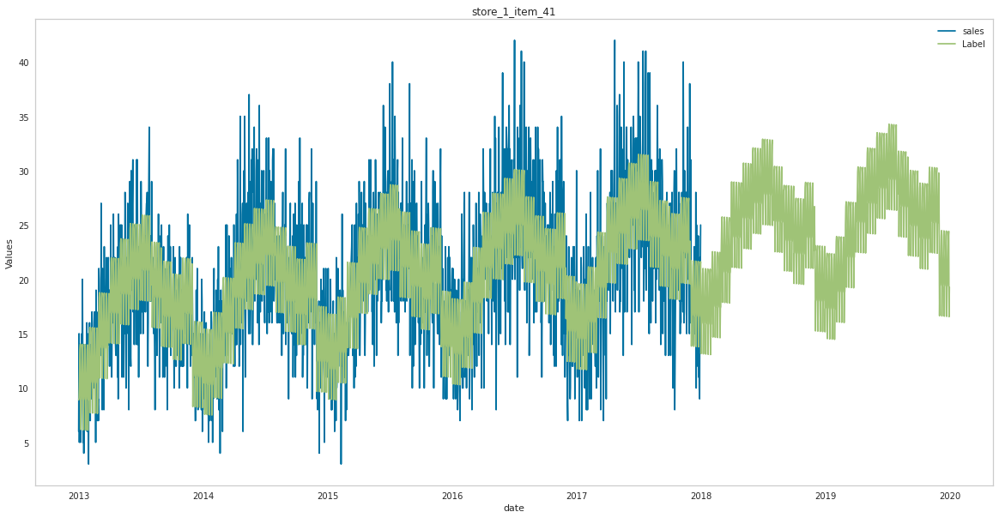

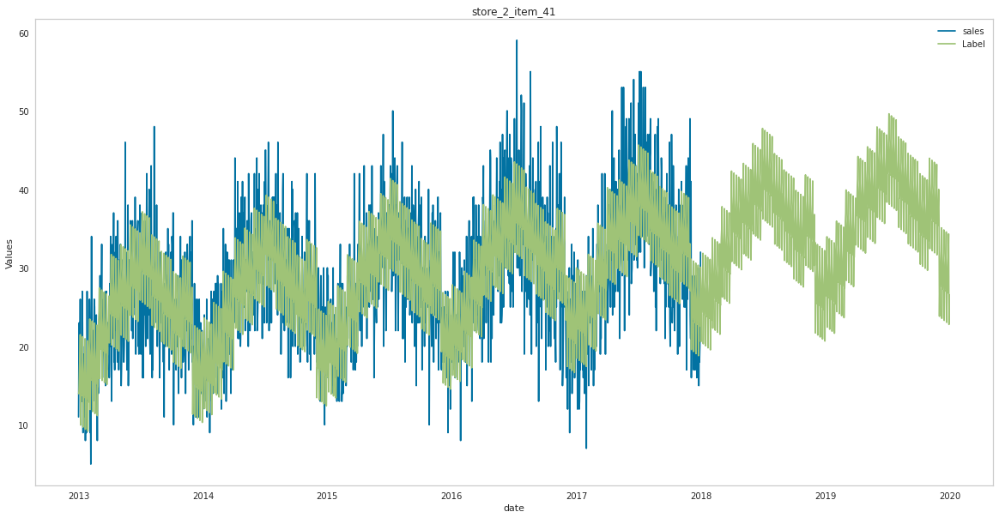

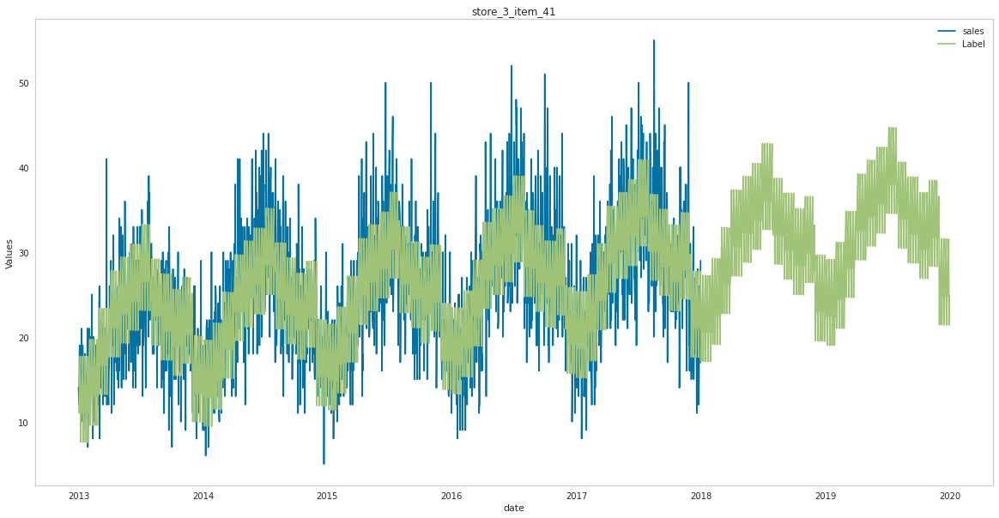

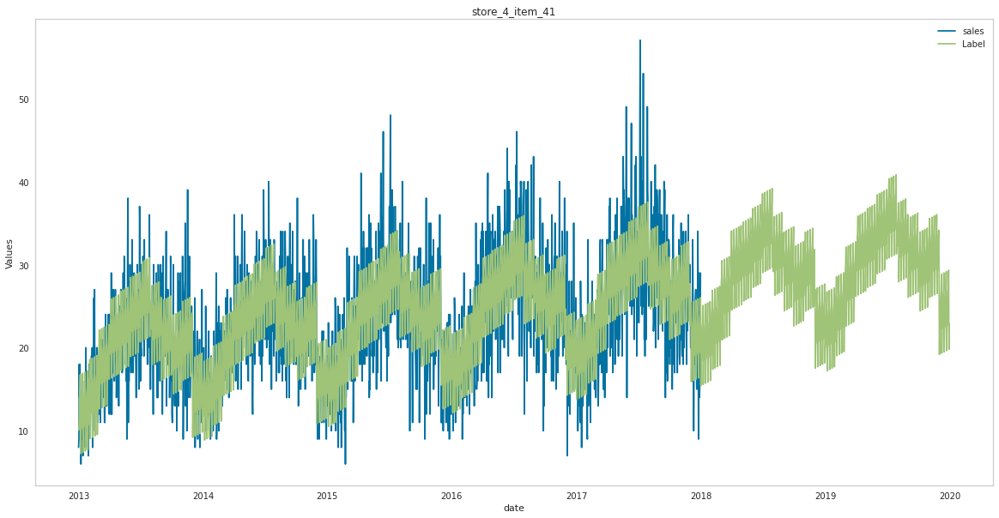

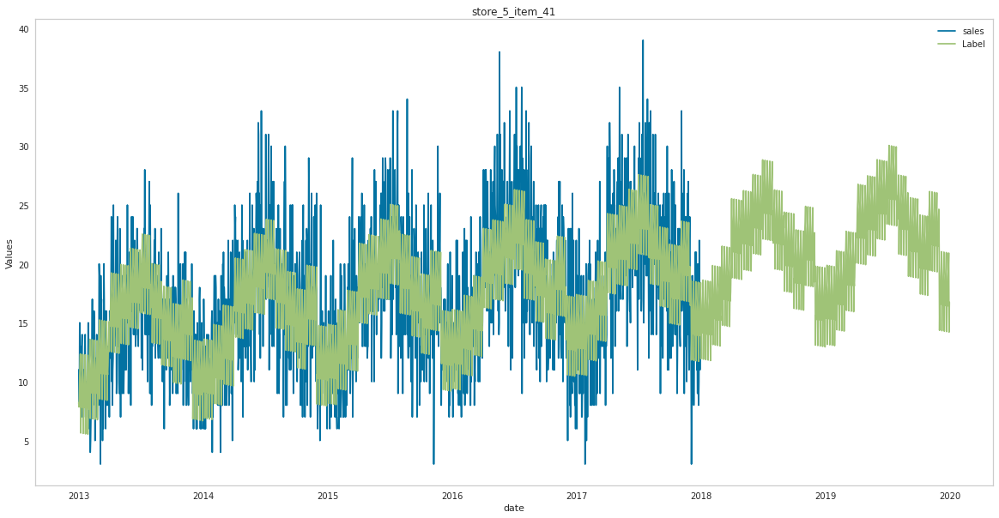

...

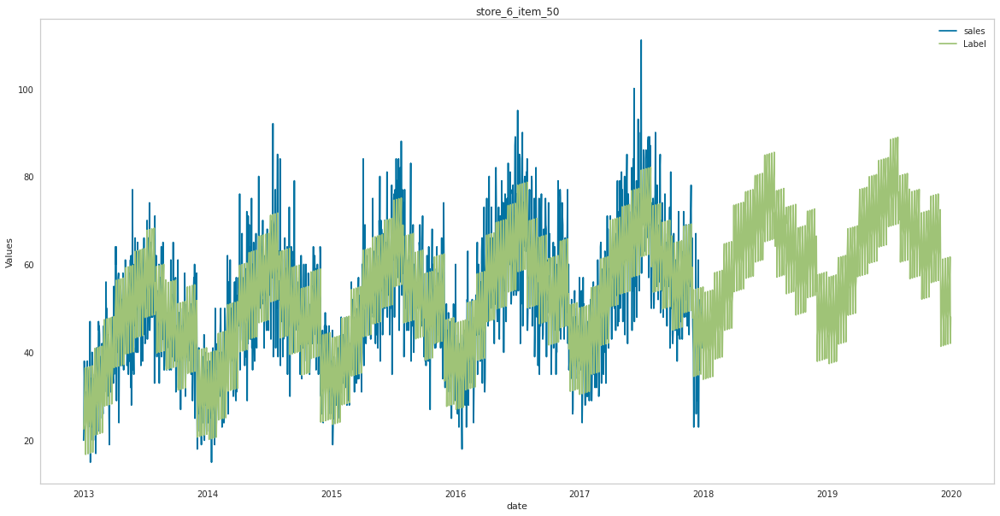

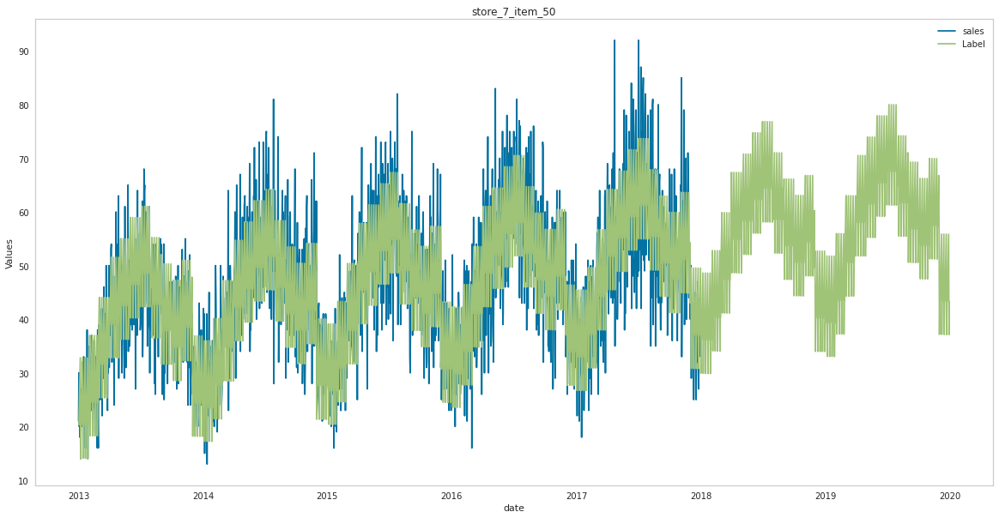

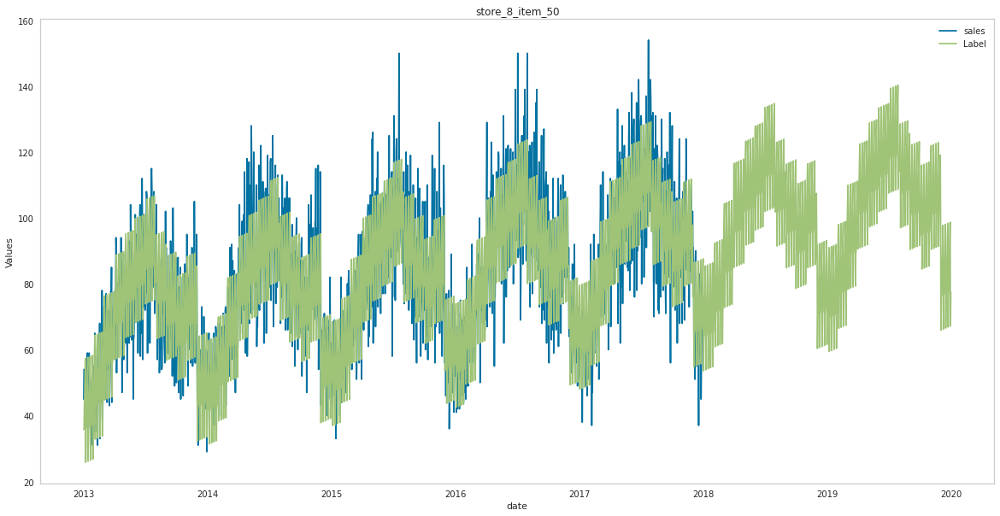

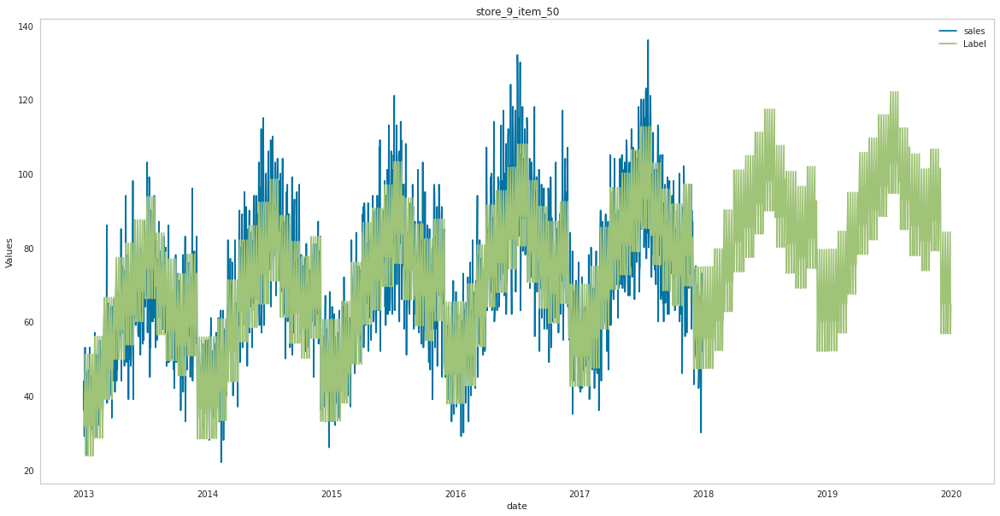

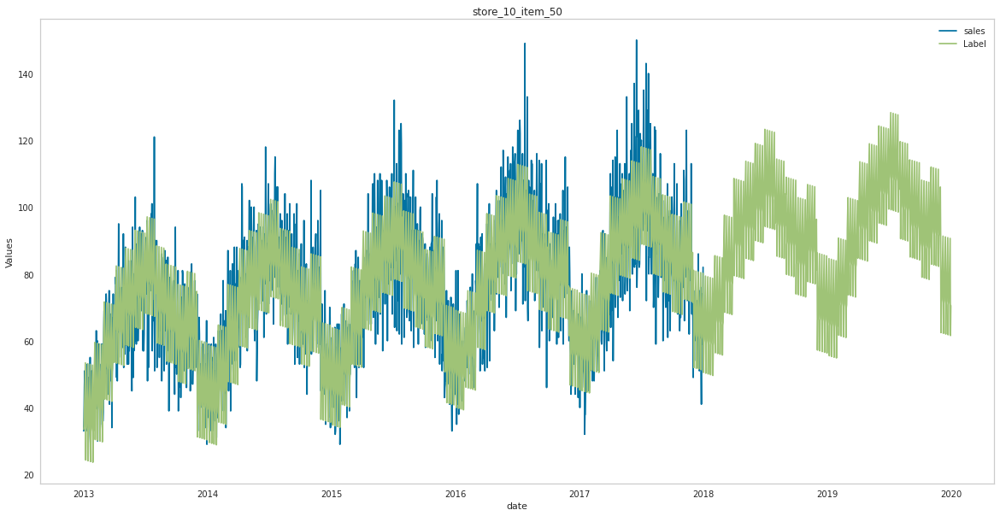

In [76]:
#tampilkan hasil
for i in data['time_series'].unique()[400:500]:
    sub_df = final_df[final_df['time_series'] == i]
    #set figure size
    plt.figure(figsize = (20,10))
    #lineplot
    sns.lineplot(x = 'date', y = 'sales', data = sub_df, label = 'sales')
    
    # plot using rolling average
    sns.lineplot( x = 'date', y = 'Label', data = sub_df, label = 'Label')
    
    plt.ylabel("Values")
    plt.grid()
    
    plt.title(i)